In [1]:
import geopandas as gpd
import pandas as pd
import numpy as np
import plotly.express as px
import pyproj as pj
from pyproj import Geod, CRS, Proj, Transformer

In [7]:
ls = gpd.read_file("../data/20151016cartecamionnagemontreal/CAMION TRC_MTL_polyline.shp")

In [8]:
ls = ls.to_crs("epsg:4326")

In [9]:
print(ls)

          ID_TRC   NOM_VOIE      NO  CAMION APPR_MTQ  \
0      1602102.0      Brock    None       3        f   
1      1602103.0      Brock    None       3        f   
2      1602104.0      Brock    None       3        f   
3      1602106.0       Avon    None       3        f   
4      1602107.0  Carnarvon    None       3        f   
...          ...        ...     ...     ...      ...   
45228  4011683.0       None  RCA-85       1        t   
45229  4011685.0     Masson  RCA-85       2        t   
45230  4011686.0     Masson  RCA-85       2        t   
45231  4011687.0     Masson  RCA-85       2        t   
45232  1160592.0     Masson  RCA-85       2        t   

                                                geometry  
0      LINESTRING (-73.63720 45.45105, -73.63629 45.4...  
1      LINESTRING (-73.63828 45.45148, -73.63720 45.4...  
2      LINESTRING (-73.64000 45.45222, -73.63988 45.4...  
3      LINESTRING (-73.64000 45.45222, -73.64082 45.4...  
4      LINESTRING (-73.63883 45.

In [10]:
lats = []
lons = []

#takes a while to compute
for line in ls["geometry"]:
        x, y = line.xy
        lats = np.append(lats, y)
        lons = np.append(lons, x)
        
        lats = np.append(lats, None)
        lons = np.append(lons, None)

In [12]:
names = []
route_type = []

name_raw = ls["NOM_VOIE"]
type_raw = ls["CAMION"]

#takes a while to compute
j=0
for i in range(len(lats)):
    if lats[i] != None :
        names = np.append(names, name_raw[j])
        route_type = np.append(route_type, type_raw[j])
    else:
        #names = np.append(names, None)
        #route_type = np.append(route_type, None)
        names = np.append(names, name_raw[j])
        route_type = np.append(route_type, type_raw[j])
        j+=1


In [13]:
type_string = np.empty((len(lats)), dtype=str)
type_string[route_type == 0.0] = "Inconnu"
type_string[route_type == 1.0] = "Toujours"
type_string[route_type == 2.0] = "Jour seulement"
type_string[route_type == 3.0] = "Livraison locale seulement"


order = [0.0, 1.0, 2.0, 3.0]


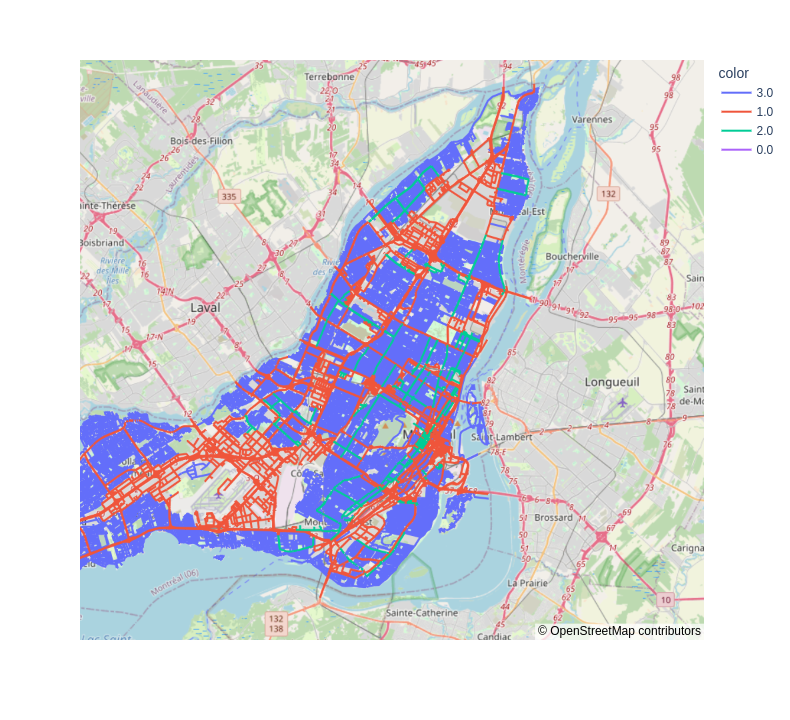

In [14]:
fig = px.line_mapbox(
lat=lats, 
lon=lons, 
mapbox_style="open-street-map",
color=route_type,
hover_name=names,
#category_orders={"route_type":order}
#animation_frame="time",
#center =dict(lon=-97.0,lat=38.0),
#zoom=3, height=600
)

fig

#fig.add_trace() to add points ? 


In [15]:
lat

NameError: name 'lat' is not defined